## Computer Vision - Homework 2

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import io
from typing import Optional, List

### Utils functions

In [ ]:
import numpy as np
from typing import List, Optional
import matplotlib.pyplot as plt

def _filter(image: np.ndarray, filt: np.ndarray) -> np.ndarray:
    """Apply a filter to an image using a specified filter matrix.

    Args:
        image (np.ndarray): Input image to which the filter is applied.
        filt (np.ndarray): 2D filter matrix to apply.

    Returns:
        np.ndarray: Filtered image.
    """
    filter_size = filt.shape[0]
    pad = filter_size // 2
    padded_img = np.pad(image, ((pad, pad), (pad, pad), (0, 0)), mode="constant")
    res = np.zeros_like(image, dtype=np.float64)  # Ensure intermediate array is float

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):

            region = padded_img[i:i+filter_size, j:j+filter_size]
            res[i, j] = np.sum(region * filt)  # Perform operations in float
            
    res = np.clip(res, 0, 255).astype(np.uint8)  # Convert back to uint8
            
    return res


def color_distance(img: np.ndarray, color: np.ndarray) -> np.ndarray:
    """Calculate the Euclidean distance between each pixel and a specified color.

    Args:
        img (np.ndarray): The input image.
        color (np.ndarray): RGB color against which distances are computed.

    Returns:
        np.ndarray: Distance of each pixel from the specified color.
    """
    return np.sqrt(((img - color) ** 2).sum(axis=2))


def highlight(img: np.ndarray, mask: np.ndarray, color: np.ndarray) -> np.ndarray:
    """Highlight specific pixels in an image based on a mask with a given color.

    Args:
        img (np.ndarray): Original image.
        mask (np.ndarray): Boolean mask array where True values specify pixels to highlight.
        color (np.ndarray): RGB color for highlighting.

    Returns:
        np.ndarray: Image with highlighted areas.
    """
    res = img.copy()
    if color.ndim == 1:
        color = np.broadcast_to(color, img[mask].shape)
    res[mask] = color
    return res


def from_rgb(r: np.ndarray, g: np.ndarray, b: np.ndarray) -> np.ndarray:
    """Combine separate R, G, and B channels into a single RGB image.

    Args:
        r, g, b (np.ndarray): Red, Green, and Blue channel arrays.

    Returns:
        np.ndarray: Combined RGB image.
    """
    return np.stack((r, g, b), axis=-1)


def transform_in_gray(img: np.ndarray) -> np.ndarray:
    """Convert an RGB image to grayscale.

    Args:
        img (np.ndarray): Input RGB image.

    Returns:
        np.ndarray: Grayscale version of the image.
    """
    r_weight, g_weight, b_weight = 0.2989, 0.587, 0.114
    grayscale_img = (
        img[:, :, 0] * r_weight +
        img[:, :, 1] * g_weight +
        img[:, :, 2] * b_weight
    )
    return grayscale_img


def comparison(imgs: List[np.ndarray], sep: int = 2) -> np.ndarray:
    """Create a comparison image with vertical slices from a list of images.

    Args:
        imgs (List[np.ndarray]): List of images to slice.
        sep (int): Width of separator between slices.

    Returns:
        np.ndarray: New image with vertical slices from each input image.
    """
    height, width, channels = imgs[0].shape
    num_imgs = len(imgs)
    slice_width = (width - sep * (num_imgs - 1)) // num_imgs
    res = np.zeros((height, width, channels), dtype=imgs[0].dtype)

    current_col = 0
    for i, img in enumerate(imgs):
        next_col = current_col + slice_width
        res[:, current_col:next_col] = img[:, current_col:next_col]
        current_col = next_col + sep

    return res

def gaussian_kernel_filter(size: int, sigma: float = 2.0) -> np.ndarray:
    # Create coordinate grid
    half_size = (size - 1) / 2
    x_coords, y_coords = np.meshgrid(
        np.arange(-half_size, half_size + 1),
        np.arange(-half_size, half_size + 1)
    )
    
    # Calculate Gaussian values
    gaussian_2d = np.exp(-(x_coords**2 + y_coords**2) / (2 * sigma**2))
    
    # Normalize the kernel
    kernel = gaussian_2d / gaussian_2d.sum()
    
    # Replicate for RGB channels
    return np.stack([kernel] * 3, axis=-1)


def show_image(image: np.ndarray, size: Optional[float] = None, *args, **kwargs) -> None:
    """Display an image using matplotlib.

    Args:
        image (np.ndarray): Image to display.
        size (Optional[float], optional): Size of the figure.
        *args, **kwargs: Additional arguments for plt.imshow.
    """
    if size is not None:
        plt.figure(figsize=(size, size))
    if "cmap" not in kwargs:
        kwargs["cmap"] = "gray"
    controller = kwargs.pop("ax", plt)
    controller.imshow(image, *args, **kwargs)
    controller.axis("off")


### The Class of filters

In [ ]:
import numpy as np
from typing import List

class Filters:
    """Class for applying various filters (Gaussian, edge detection, box filter, etc.) to images."""

    # Class variables for different filters
    gaussian_kernel_1D: np.ndarray = None
    gaussian_kernel_2D: np.ndarray = None
    box_kernel: np.ndarray = None
    identity_kernel: np.ndarray = None
    n: int
    sigma: float

    def __init__(self, n: int = 3, sigma: float = 2) -> None:
        """Initialize filter kernels (Gaussian, box, identity) for given kernel size `n` and standard deviation `sigma`."""
        meshrange = np.arange(-(n // 2), (n // 2) + 1)

        # Create and normalize 1D Gaussian kernel
        self.gaussian_kernel_1D = np.exp(-(meshrange**2) / (2 * sigma**2))
        self.gaussian_kernel_1D /= self.gaussian_kernel_1D.sum()

        # Create and normalize 2D Gaussian kernel for RGB
        h1, h2 = np.meshgrid(meshrange, meshrange)
        self.gaussian_kernel_2D = np.exp(-(h1**2 + h2**2) / (2 * sigma**2))
        self.gaussian_kernel_2D /= self.gaussian_kernel_2D.sum()
        self.gaussian_kernel_2D = np.stack((self.gaussian_kernel_2D, self.gaussian_kernel_2D, self.gaussian_kernel_2D), axis=-1)

        self.n = n
        self.sigma = sigma

        # Create box kernel
        self.box_kernel = np.ones((self.n, self.n)) / (self.n * self.n)

        # Create identity kernel for odd-sized filters
        if self.n % 2 == 1:
            self.identity_kernel = np.zeros((self.n, self.n))
            self.identity_kernel[self.n // 2, self.n // 2] = 1

    def mono_filter(self, image: np.ndarray, filtr: np.ndarray) -> np.ndarray:
        """Apply a single-channel filter to an image."""
        pad = self.n // 2
        # Adjust padding to handle multi-channel inputs
        padded_img = np.pad(image, ((pad, pad), (pad, pad)) + ((0, 0),) if image.ndim == 3 else ((pad, pad), (pad, pad)), mode='constant')
        res = np.zeros_like(image)

        # Ensure the filter is single-channel for grayscale images
        if image.ndim == 2 and filtr.ndim == 3:
            filtr = filtr[:, :, 0]

        # Apply filter
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                region = padded_img[i:i+self.n, j:j+self.n]
                if image.ndim == 3:
                    for c in range(image.shape[2]):  # Multi-channel
                        res[i, j, c] = np.sum(region[:, :, c] * filtr)
                else:
                    res[i, j] = np.sum(region * filtr)  # Single-channel
                
        return res

    def detect_edges(self, image: np.ndarray, fx: np.ndarray, fy: np.ndarray) -> np.ndarray:
        """Detect edges in an image using the given x and y derivative filters."""
        img_y = self.mono_filter(image, fy)
        img_x = self.mono_filter(image, fx)
        edge_magnitude = np.hypot(img_x, img_y)

        # Normalize edge magnitudes
        if edge_magnitude.max() > 0:
            edge_magnitude /= edge_magnitude.max()

        return edge_magnitude

    def get_filter(self, mono_filter: List[List[float]]) -> np.ndarray:
        """Expand a single-channel filter to 3 channels (RGB)."""
        return np.stack((mono_filter, mono_filter, mono_filter), axis=-1)

    # Edge detection filters (Sobel, Prewitt, Roberts, custom)
    def sobel_x_dir(self) -> np.ndarray:
        return self.get_filter(np.array([
            [-1, 0, 1],
            [-2, 0, 2],
            [-1, 0, 1],
        ]))

    def sobel_y_dir(self) -> np.ndarray:
        return self.get_filter(np.array([
            [1, 2, 1],
            [0, 0, 0],
            [-1, -2, -1],
        ]))

    def prewitt_x_dir(self) -> np.ndarray:
        return self.get_filter(np.array([
            [-1, 0, 1],
            [-1, 0, 1],
            [-1, 0, 1],
        ]))

    def prewitt_y_dir(self) -> np.ndarray:
        return self.get_filter(np.array([
            [1, 1, 1],
            [0, 0, 0],
            [-1, -1, -1],
        ]))

    def roberts_x_dir(self) -> np.ndarray:
        return self.get_filter(np.array([
            [0, 1],
            [-1, 0],
        ]))

    def roberts_y_dir(self) -> np.ndarray:
        return self.get_filter(np.array([
            [1, 0],
            [0, -1],
        ]))

    def custom_x_dir(self) -> np.ndarray:
        return self.get_filter(np.array([
            [-1, 0, 0, 1],
            [-3, 0, 0, 3],
            [-3, 0, 0, 3],
            [-1, 0, 0, 1],
        ]))

    def custom_y_dir(self) -> np.ndarray:
        return self.get_filter(np.array([
            [-1, -3, -3, -1],
            [0, 0, 0, 0],
            [0, 0, 0, 0],
            [1, 3, 3, 1],
        ]))

    def identity_filter(self, image: np.ndarray) -> np.ndarray:
        """Apply the identity kernel to an RGB image."""
        pad = self.n // 2
        padded_img = np.pad(image, ((pad, pad), (pad, pad), (0, 0)), mode='constant')
        res = np.zeros_like(image)

        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                region = padded_img[i:i+self.n, j:j+self.n]
                for c in range(3):
                    res[i, j, c] = np.sum(region[:, :, c] * self.identity_kernel)
        
        return res

    def gaussian_filter(self, image: np.ndarray) -> np.ndarray:
        """Apply a 1D Gaussian filter in two passes (horizontal and vertical)."""
        pad = self.n // 2
        padded_img = np.pad(image, ((pad, pad), (pad, pad), (0, 0)), mode='constant')
        temp_res = np.zeros_like(image)

        # Horizontal pass
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                for c in range(3):
                    temp_res[i, j, c] = np.sum(padded_img[i, j:j+self.n, c] * self.gaussian_kernel_1D)

        res = np.zeros_like(image)
        padded_temp_res = np.pad(temp_res, ((pad, pad), (0, 0), (0, 0)), mode='constant')

        # Vertical pass
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                for c in range(3):
                    res[i, j, c] = np.sum(padded_temp_res[i:i+self.n, j, c] * self.gaussian_kernel_1D)

        return res

    def inefficient_gaussian_filter(self) -> np.ndarray:
        """Create a 2D Gaussian kernel of size `n` with standard deviation `sigma`."""
        offset = (self.n - 1) / 2
        meshrange = np.arange(-offset, offset + 1)

        x, y = np.meshgrid(meshrange, meshrange)
        kernel_2d = np.exp(-(x**2 + y**2) / (2 * self.sigma**2))

        kernel_2d /= kernel_2d.sum()
        return np.stack((kernel_2d, kernel_2d, kernel_2d), axis=-1)

    def box_filter(self, image: np.ndarray) -> np.ndarray:
        """Apply a box filter to an RGB image."""
        pad = self.n // 2
        padded_img = np.pad(image, ((pad, pad), (pad, pad), (0, 0)), mode='constant')
        res = np.zeros_like(image)

        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                region = padded_img[i:i+self.n, j:j+self.n]
                for c in range(3):
                    res[i, j, c] = np.sum(region[:, :, c] * self.box_kernel)

        return res


## 2 & 3

In [4]:
paths_list = [
    "./imgs/Gura_Portitei_Scara_0025.jpg",
    "./imgs/Gura_Portitei_Scara_010.jpg",
    "./imgs/Gura_Portitei_Scara_020.jpg",
    "./imgs/Gura_Portitei_Scara_040.jpg",
    "./imgs/Gura_Portitei_Scara_080.jpg",
    "./imgs/Gura_Portitei_Scara_100.jpg",
]

filters = Filters()

blurred_imgs = {
    path : filters.gaussian_filter(io.imread(path))
    for path in paths_list
}

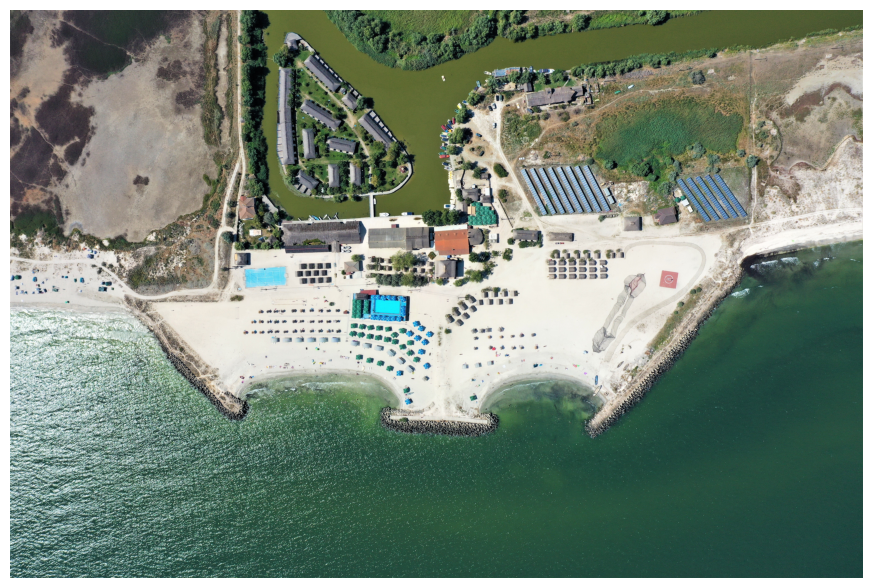

In [5]:
show_image(io.imread(paths_list[-1]), size=11)

<Figure size 1500x2000 with 0 Axes>

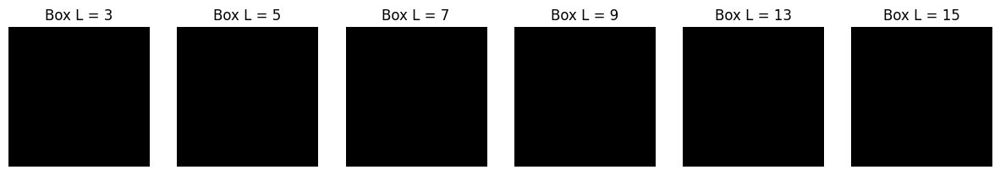

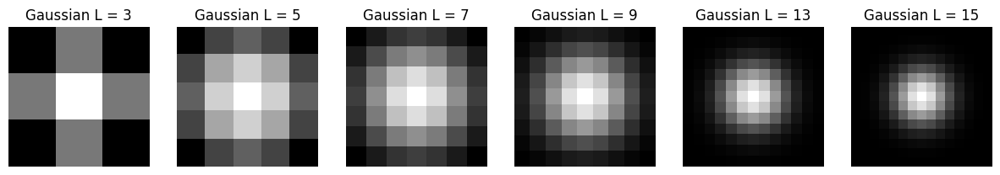

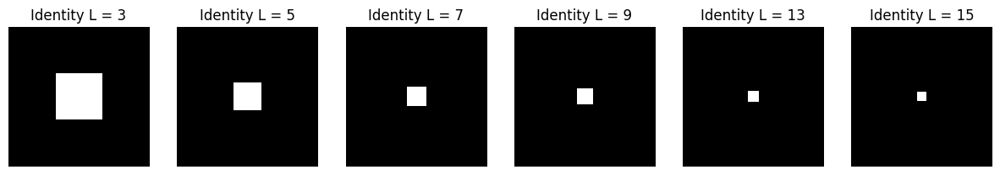

In [6]:
def plot_func(arg : int):

    if arg == 1:
        for i, filtr in enumerate(filters_lst):
            
            plt.subplot(1, len(filters_lst), i + 1)
            plt.title(f'Box L = {filtr.n}')
            show_image(filtr.box_kernel[:, :] * 255)

    elif arg == 2:
        for i, filtr in enumerate(filters_lst):

            plt.subplot(1, len(filters_lst), i + 1)
            plt.title(f'Gaussian L = {filtr.n}')
            show_image(filtr.gaussian_kernel_2D[:, :, 0] * 255)

    elif arg == 3:
        for i, filtr in enumerate(filters_lst):

            plt.subplot(1, len(filters_lst), i + 1)
            plt.title(f'Identity L = {filtr.n}')
            show_image(filtr.identity_kernel[:, :] * 255)


filters_lst = [Filters(3), Filters(5), Filters(7), Filters(9), Filters(13), Filters(15)]

for i in range(4):

    plt.figure(figsize=(15, 20))
    plot_func(i)
    plt.show()

In [ ]:
box_images = [io.imread(paths_list[2])]

gaussian_images = [io.imread(paths_list[2])]

identity_images = [io.imread(paths_list[2])]

for filtr in filters_lst:
    identity_images = identity_images + [filtr.identity_filter(identity_images[0])]

for filtr in filters_lst:
    box_images = box_images + [filtr.box_filter(box_images[0])]

for filtr in filters_lst:
    gaussian_images = gaussian_images + [filtr.gaussian_filter(gaussian_images[0])]

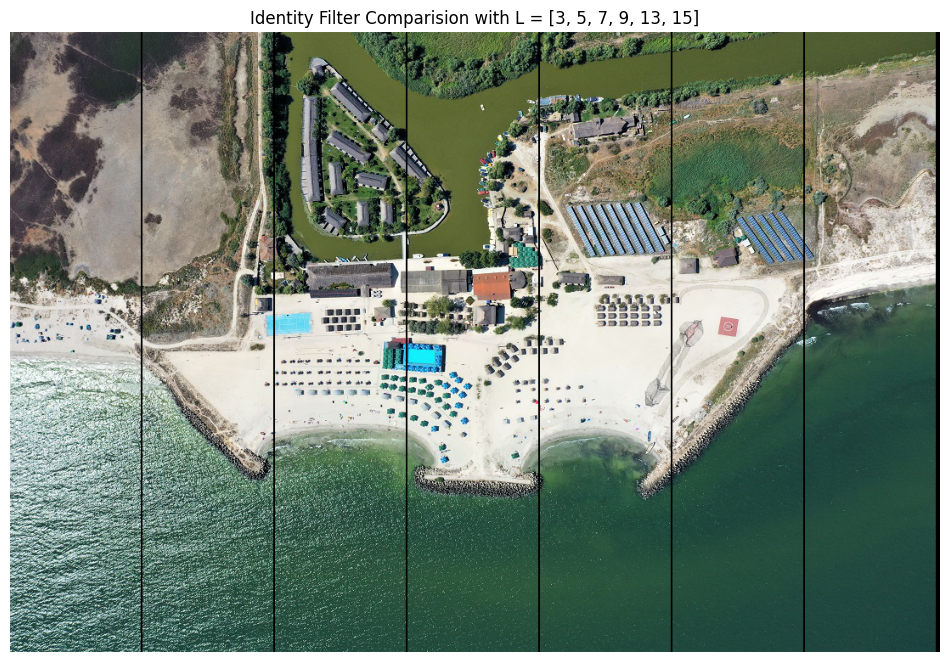

In [51]:
show_image(comparison(identity_images), size = 12)
plt.title(f'Identity Filter Comparision with L = [3, 5, 7, 9, 13, 15]')
plt.show()

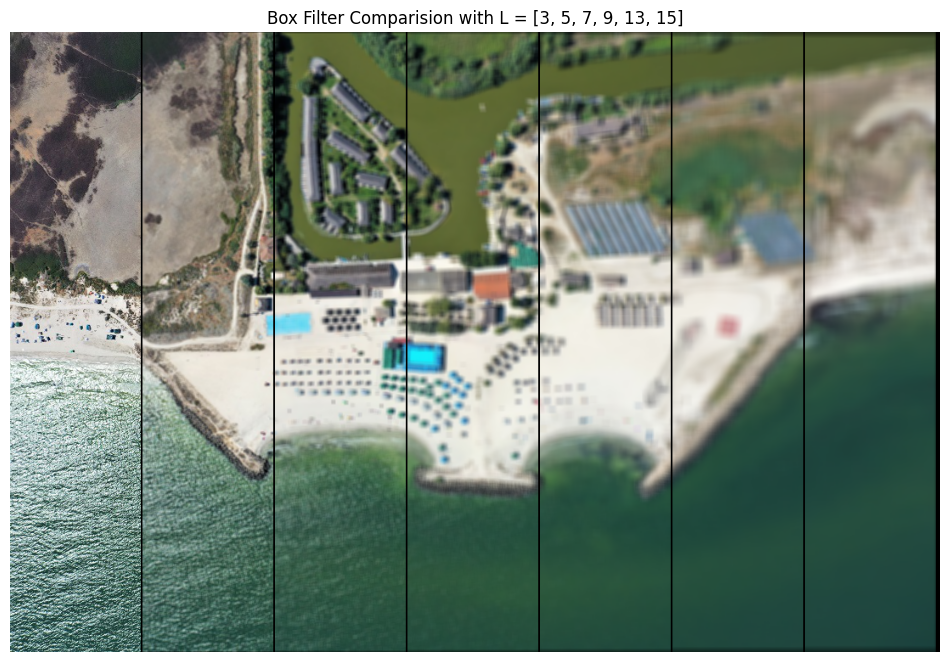

In [52]:
show_image(comparison(box_images), size = 12)
plt.title(f'Box Filter Comparision with L = [3, 5, 7, 9, 13, 15]')
plt.show()

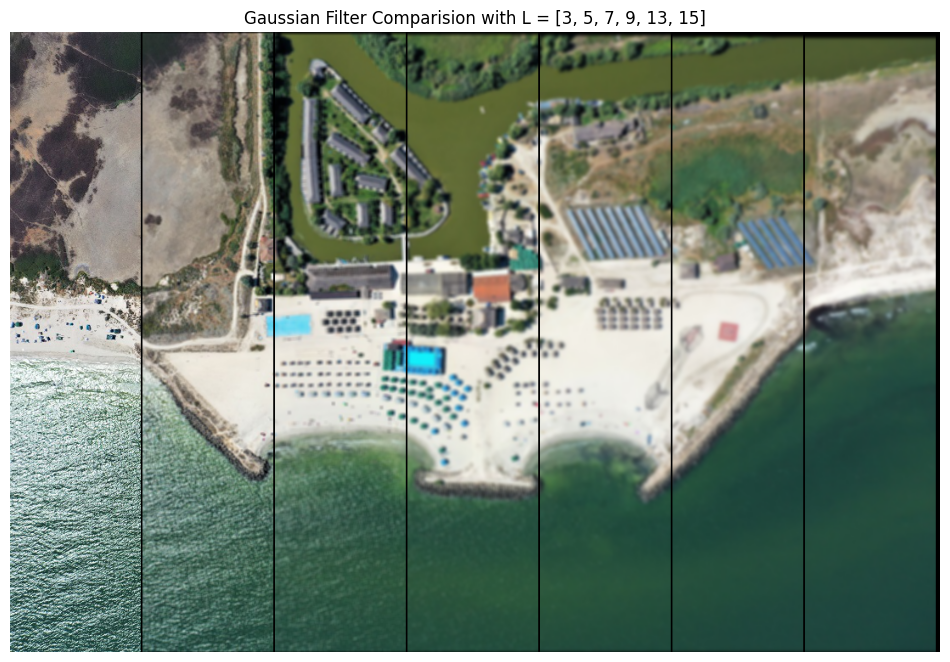

In [53]:
show_image(comparison(gaussian_images), size = 12)
plt.title(f'Gaussian Filter Comparision with L = [3, 5, 7, 9, 13, 15]')
plt.show()

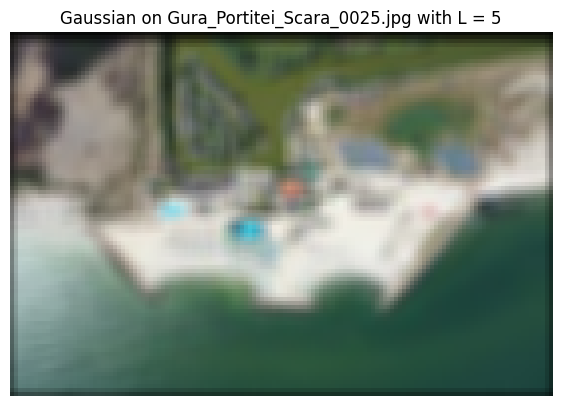

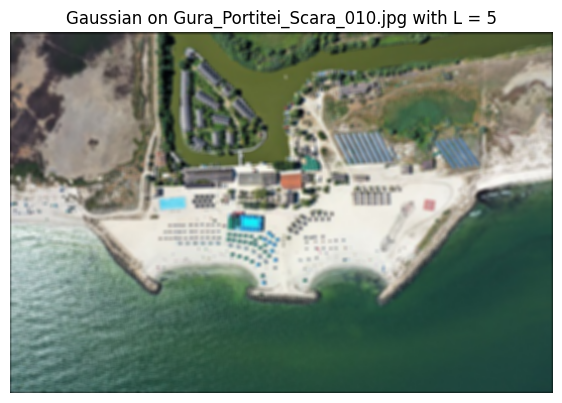

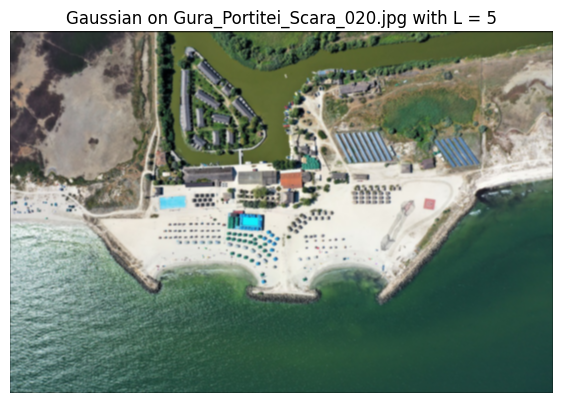

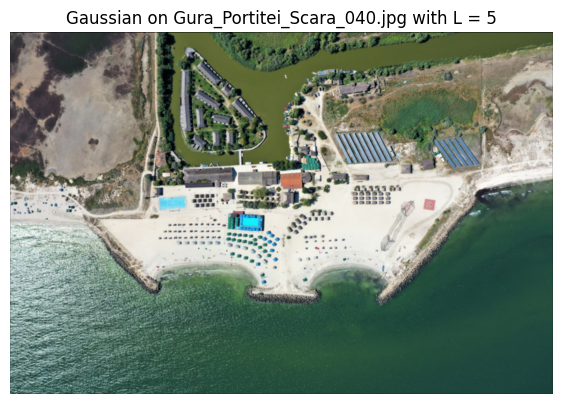

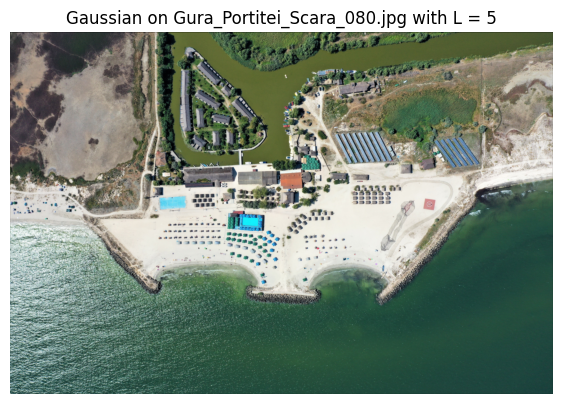

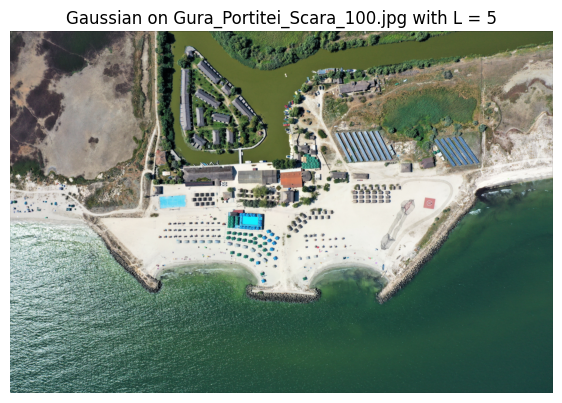

In [66]:
for img in paths_list:

    show_image(filters_lst[1].gaussian_filter(io.imread(img)), size = 7)
    plt.title(f'Gaussian on {img[7:]} with L = 5')
    plt.show()

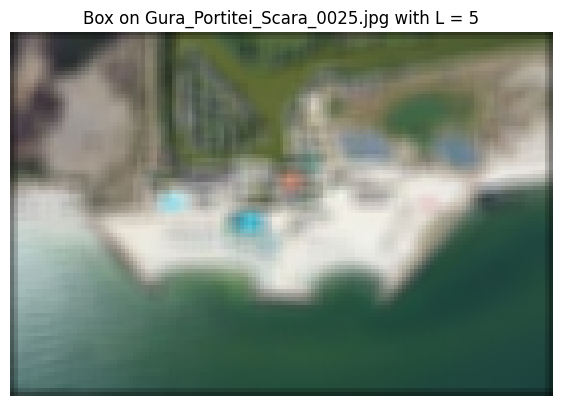

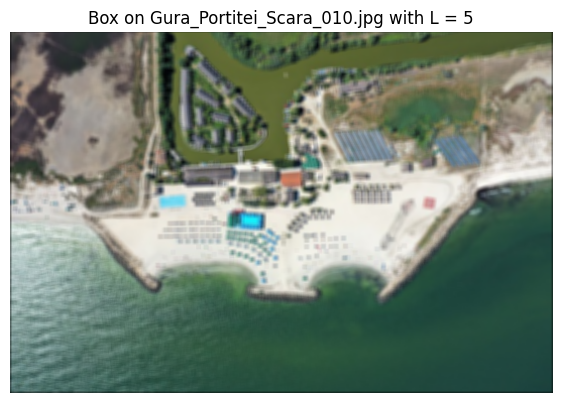

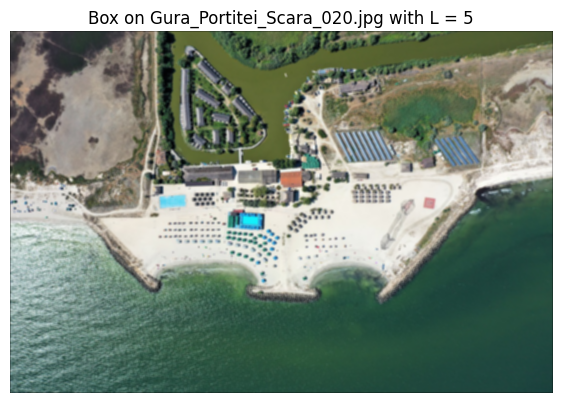

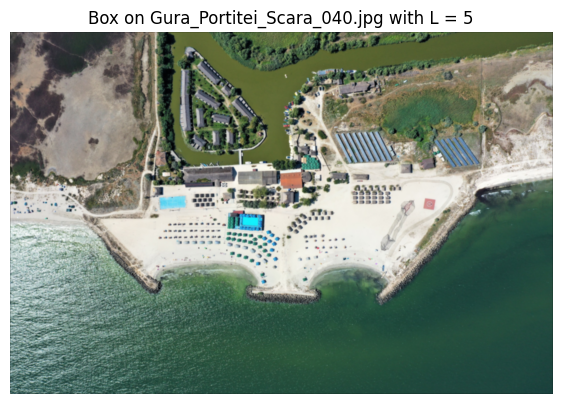

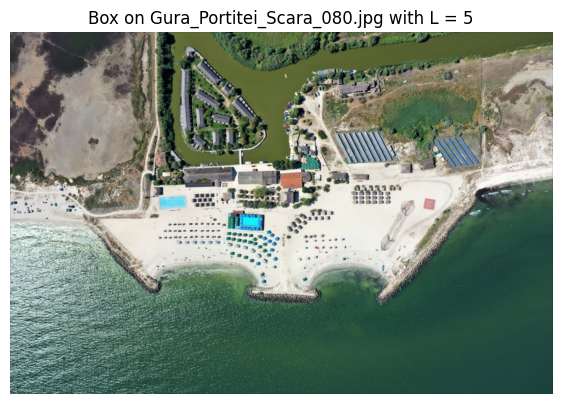

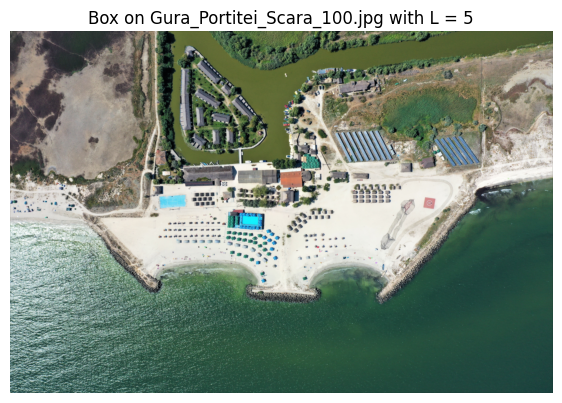

In [64]:
for img in paths_list:

    show_image(filters_lst[1].box_filter(io.imread(img)), size = 7)
    plt.title(f'Box on {img[7:]} with L = 5')
    plt.show()

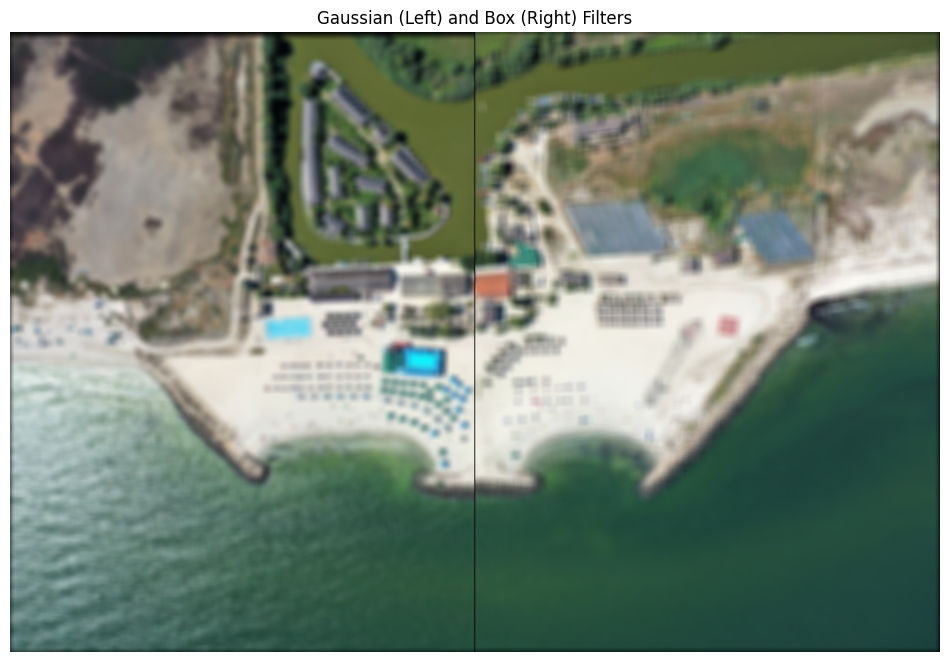

In [8]:
fltr = Filters(23, sigma = 8)
images = [fltr.gaussian_filter(io.imread(paths_list[3])), fltr.box_filter(io.imread(paths_list[3]))]

show_image(comparison(images), size = 12)
plt.title("Gaussian (Left) and Box (Right) Filters")
plt.show()

Text(0.5, 1.0, 'Roberts y Dir')

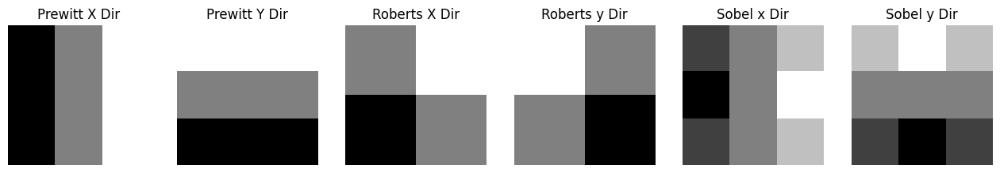

In [9]:
filtr = Filters()

plt.figure(figsize = (16, 10))

plt.subplot(1, 6, 5)
show_image(filtr.sobel_x_dir()[:, :, 0])
plt.gca().set_title("Sobel x Dir")

plt.subplot(1, 6, 6)
show_image(filtr.sobel_y_dir()[:, :, 0])
plt.gca().set_title("Sobel y Dir")

plt.subplot(1, 6, 1)
show_image(filtr.prewitt_x_dir()[:, :, 0])
plt.gca().set_title("Prewitt X Dir")

plt.subplot(1, 6, 2)
show_image(filtr.prewitt_y_dir()[:, :, 0])
plt.gca().set_title("Prewitt Y Dir")

plt.subplot(1, 6, 3)
show_image(filtr.roberts_x_dir()[:, :, 0])
plt.gca().set_title("Roberts X Dir")

plt.subplot(1, 6, 4)
show_image(filtr.roberts_y_dir()[:, :, 0])
plt.gca().set_title("Roberts y Dir")


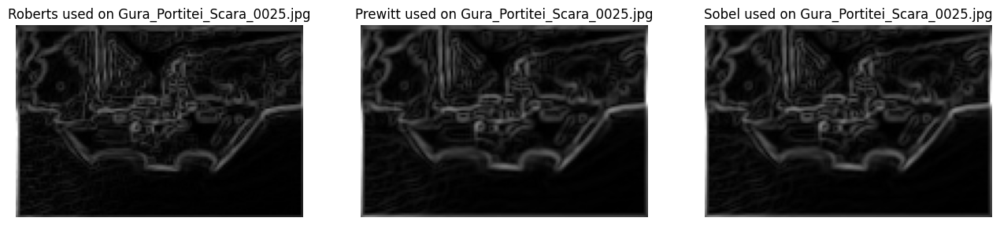

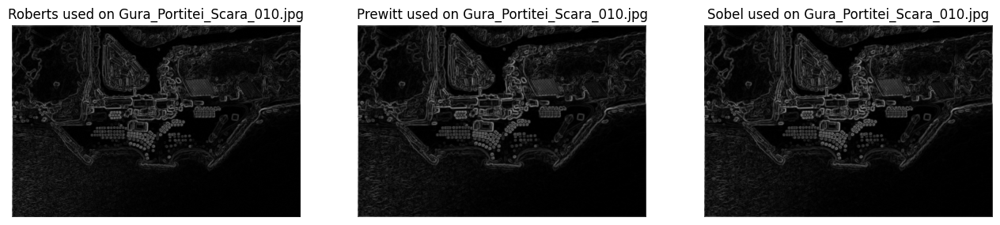

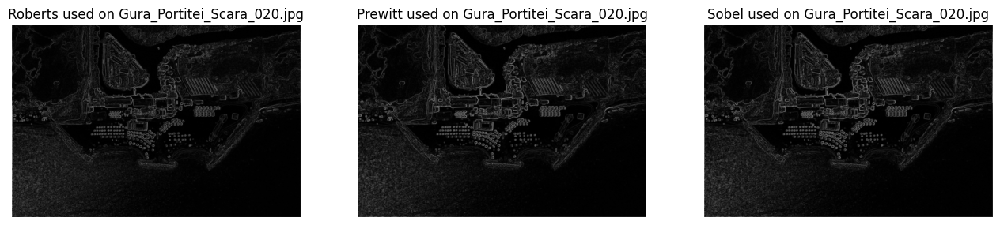

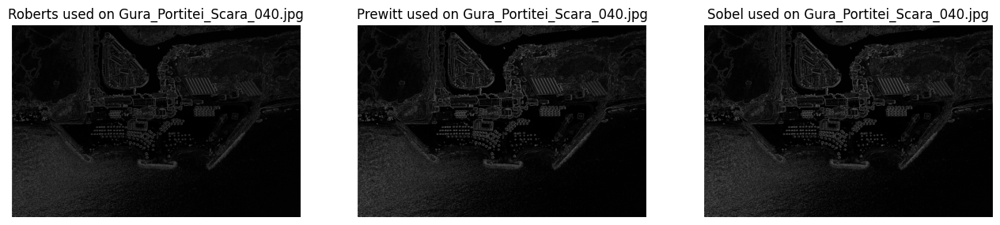

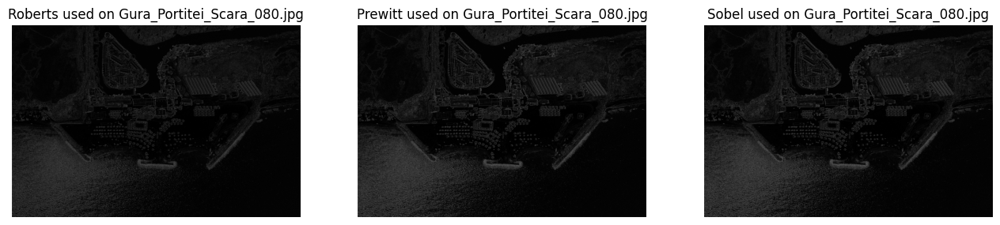

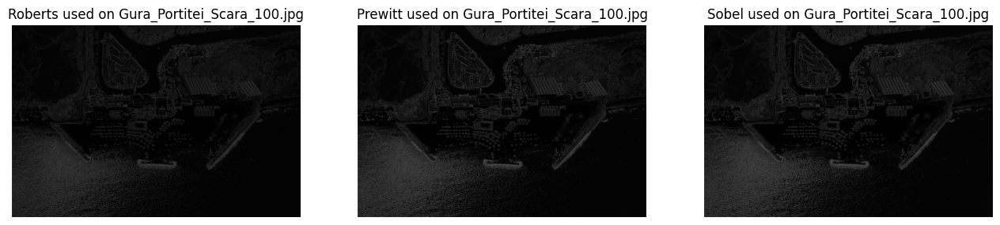

In [10]:
roberts = Filters(2)

for path in paths_list:
    image = blurred_imgs[path]
    image = transform_in_gray(image)

    img_roberts = roberts.detect_edges(image, roberts.roberts_x_dir()[:, :, 0], roberts.roberts_y_dir()[:, :, 0])
    img_prewitt = filtr.detect_edges(image, filtr.prewitt_x_dir()[:, :, 0], filtr.prewitt_y_dir()[:, :, 0])
    img_sobel = filtr.detect_edges(image, filtr.sobel_x_dir()[:, :, 0], filtr.sobel_y_dir()[:, :, 0])

    plt.figure(figsize =(16, 10))

    plt.subplot(1, 3, 1)
    show_image(img_roberts)
    plt.gca().set_title(f'Roberts used on {path[7:]}')

    plt.subplot(1, 3, 2)
    show_image(img_prewitt)
    plt.gca().set_title(f'Prewitt used on {path[7:]}')

    plt.subplot(1, 3, 3)
    show_image(img_sobel)
    plt.gca().set_title(f'Sobel used on {path[7:]}')

Text(0.5, 1.0, 'Custom y Dir')

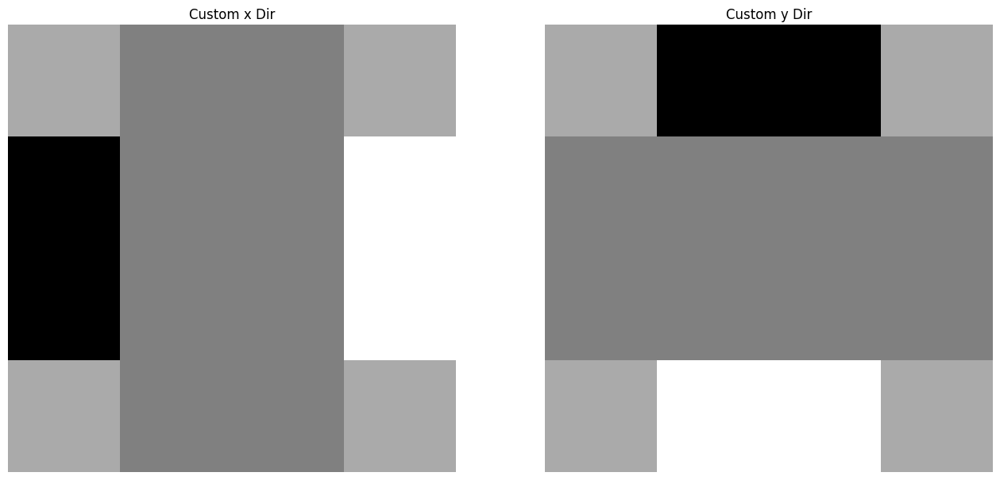

In [14]:
filtr = Filters()

plt.figure(figsize = (16, 10))

plt.subplot(1, 2, 1)
show_image(filtr.custom_x_dir()[:, :, 0])
plt.gca().set_title("Custom x Dir")

plt.subplot(1, 2, 2)
show_image(filtr.custom_y_dir()[:, :, 0])
plt.gca().set_title("Custom y Dir")


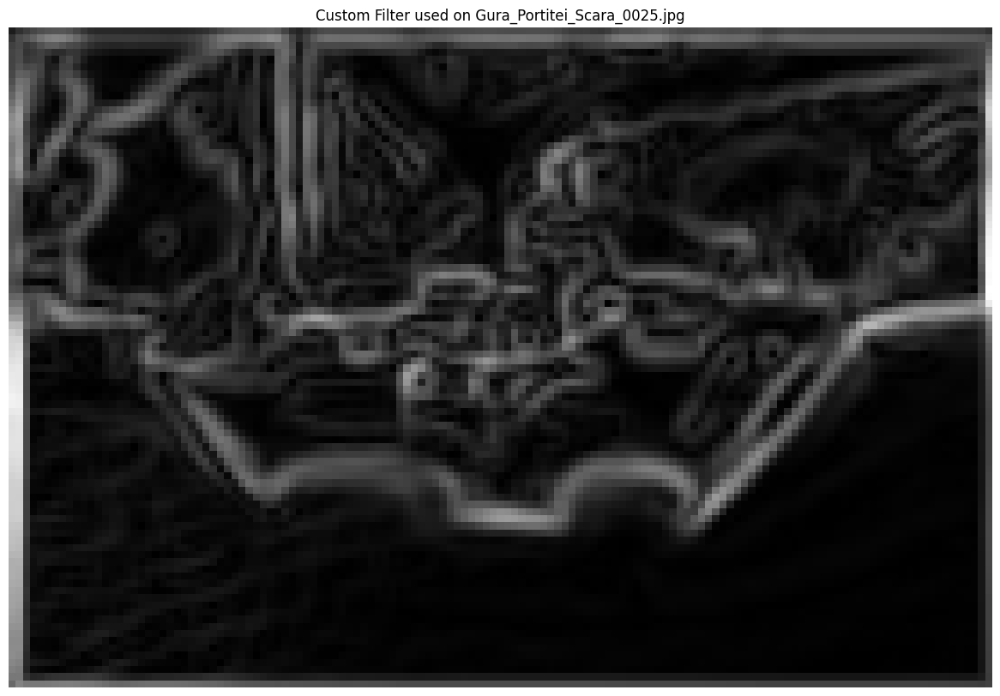

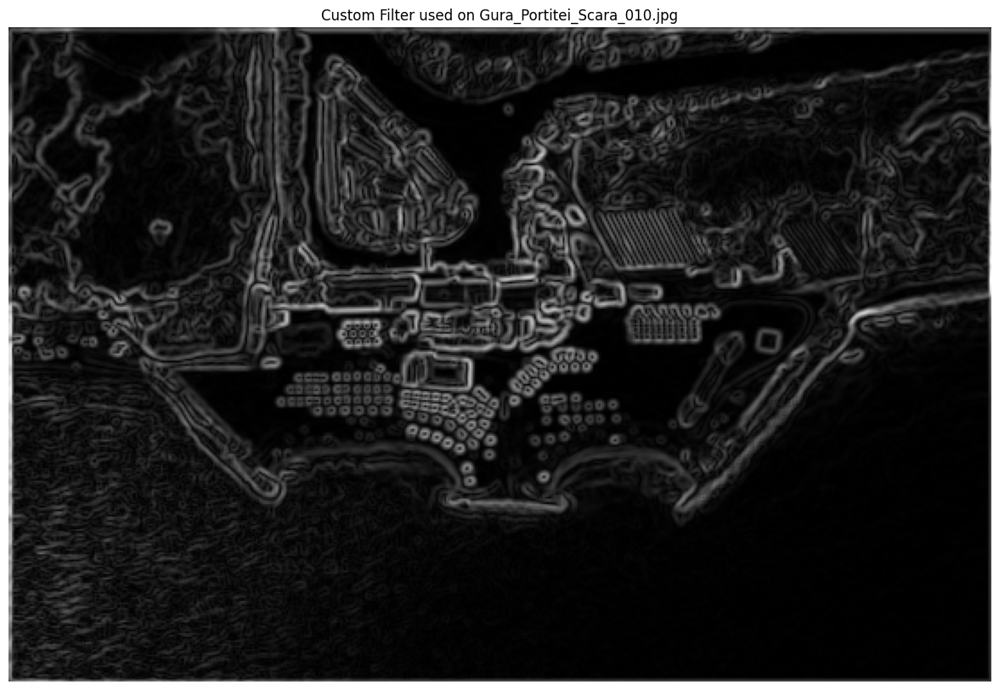

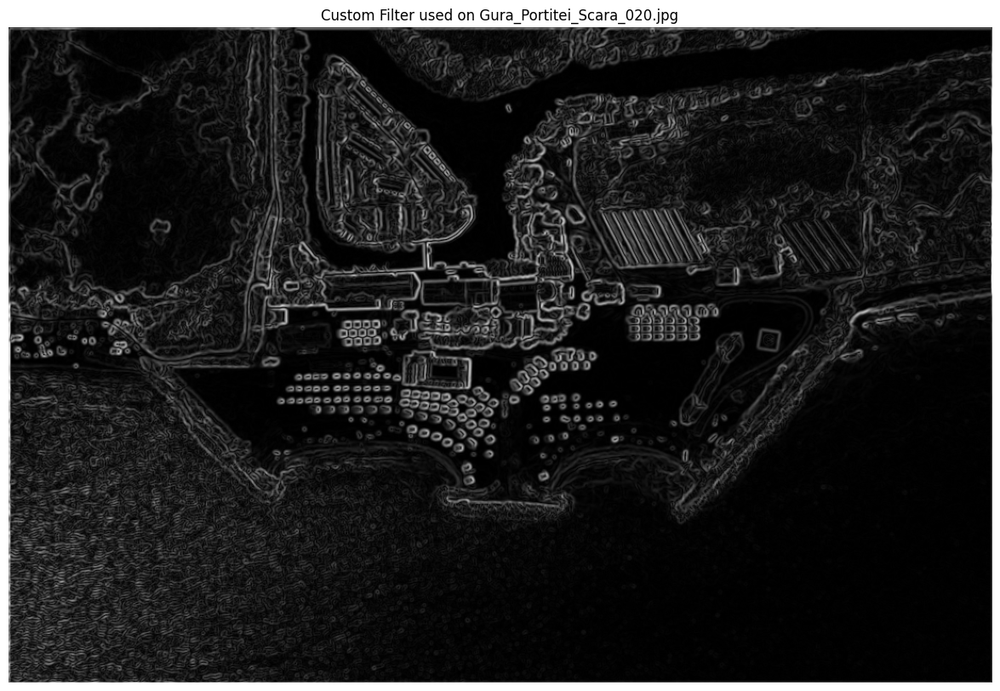

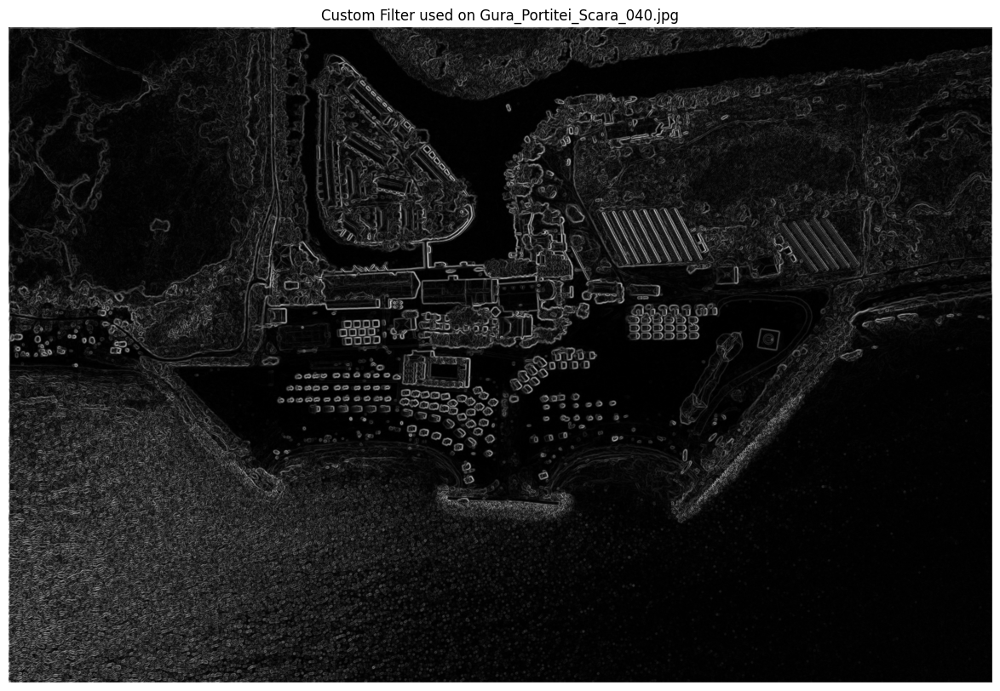

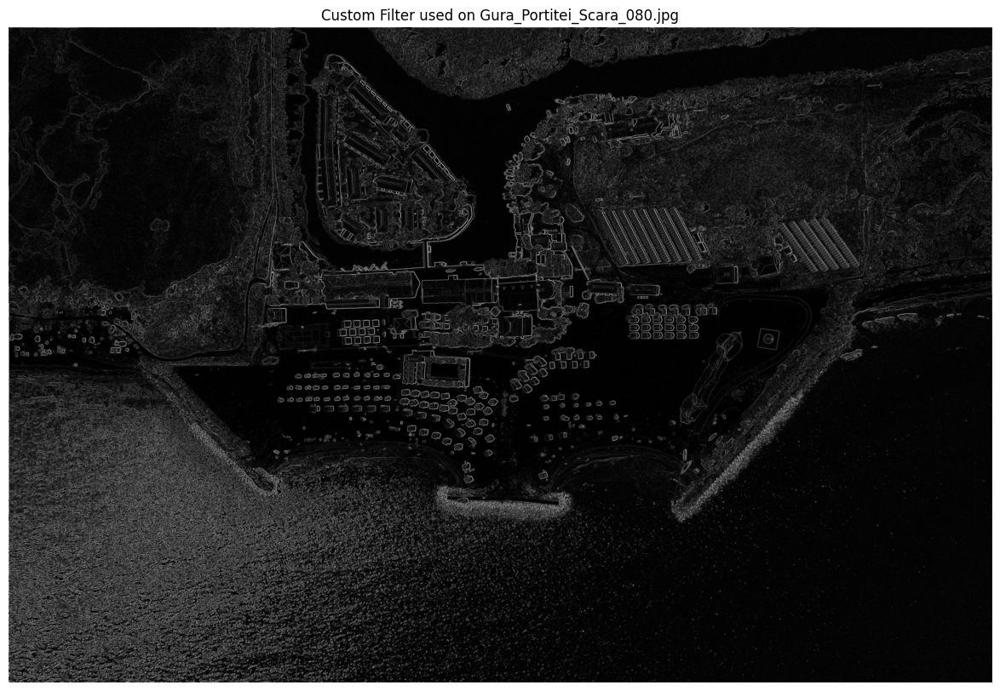

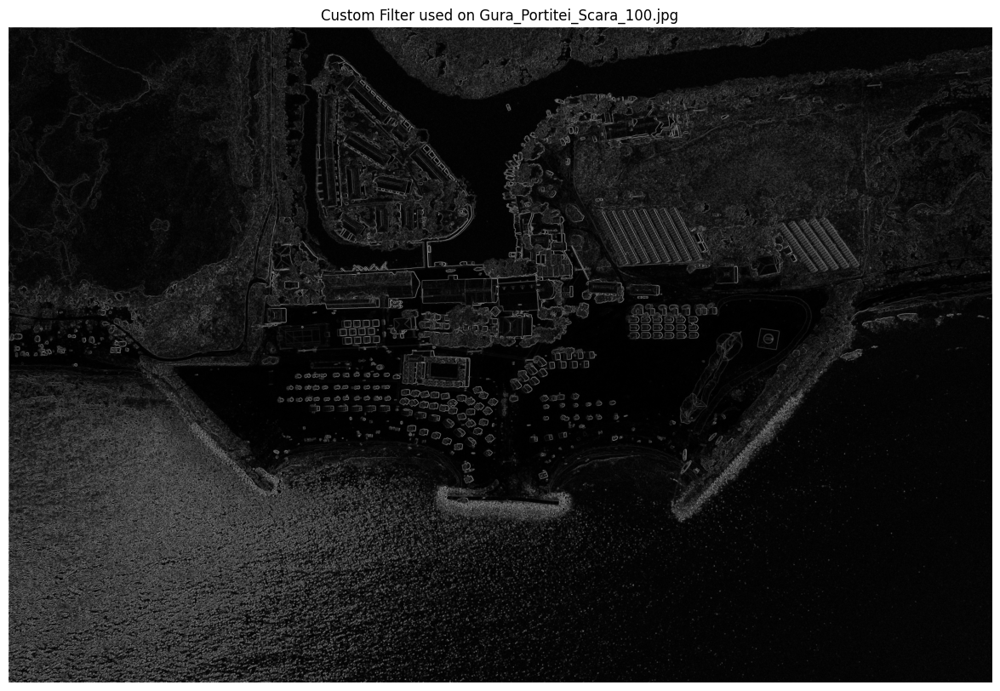

In [123]:
custom = Filters(4)

for path in paths_list:
    image = blurred_imgs[path]
    image = transform_in_gray(image)

    img_custom = custom.detect_edges(image, custom.custom_x_dir()[:, :, 0], custom.custom_y_dir()[:, :, 0])

    plt.figure(figsize =(16, 10))

    show_image(img_custom)
    plt.gca().set_title(f'Custom Filter used on {path[7:]}')

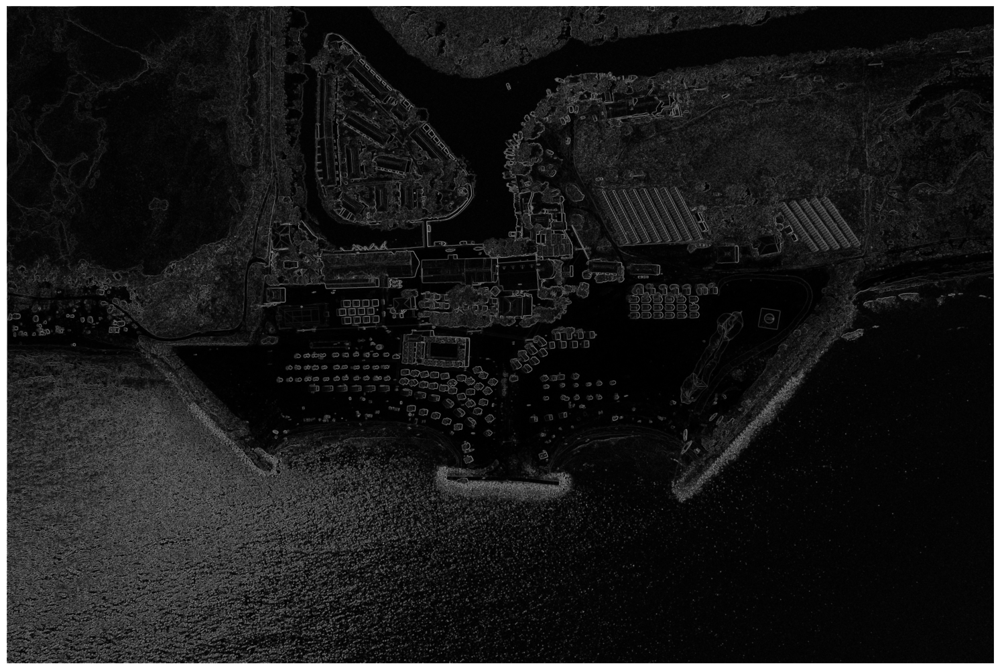

In [124]:
show_image(img_custom, size = 19)

## 4.1

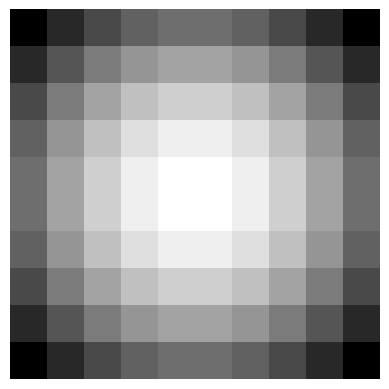

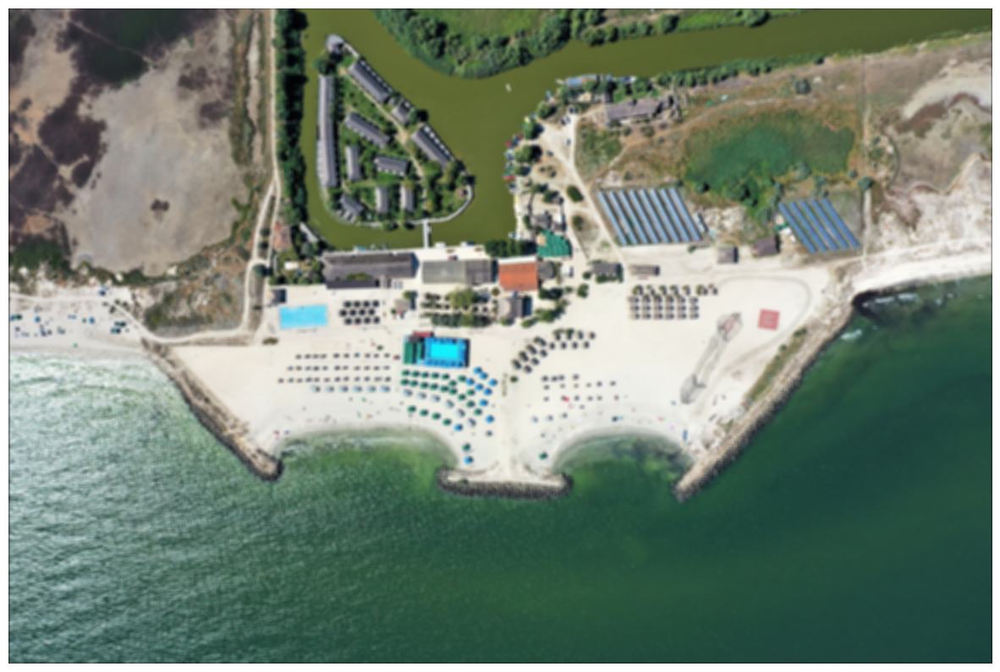

In [ ]:
# Load an image from the file path list (here, using the fourth path in paths_list)
initial_image = io.imread(paths_list[3])

# Create an instance of the Filters class with kernel size 10 and sigma 6
gauss = Filters(10, 6)

# Apply a Gaussian filter to the initial image using the 2D Gaussian kernel of the Filters instance
gaussian_image = _filter(initial_image, gaussian_kernel_filter(10, 6)) 

# Display the Gaussian kernel (showing one channel of the 2D kernel)
show_image(gauss.gaussian_kernel_2D[:, :, 0])
plt.show()

# Display the filtered image with a larger figure size of 15
show_image(gaussian_image, size=15)
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..2.0].


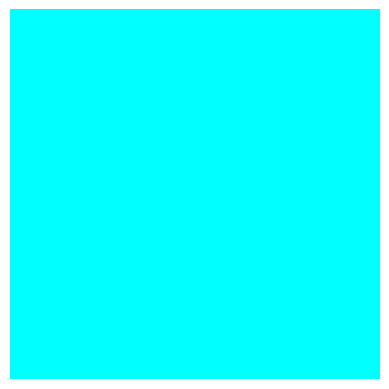

In [97]:
cyan = from_rgb(
    r=np.full((3, 3), -1),
    g=np.full((3, 3), 0.5),
    b=np.full((3, 3), 1)
)

show_image(cyan - cyan.min())

In [ ]:
# Apply a filter with a cyan color filter on the Gaussian filtered image
gaussian_image_masked = _filter(gaussian_image, cyan)

# Transform the masked Gaussian image to grayscale
gaussian_image_masked = transform_in_gray(gaussian_image_masked)

# Display the resulting grayscale image with a figure size of 20
show_image(gaussian_image_masked, size=20)

# Save the displayed plot into the "outputs" directory
plt.savefig("outputs/image_gen_step1.jpg")

In [ ]:
# Set the threshold value for filtering the image
thrs = 0.82

# Display the binary thresholded image, where pixels are set to True if they exceed 82% of the max value
show_image(gaussian_image_masked / gaussian_image_masked.max() > thrs, size=17)

# Save the displayed plot into the "outputs" directory
plt.savefig("outputs/image_gen_step2.jpg")


In [ ]:
# Define the red color in RGB format
red_color = np.asarray([255, 0, 0])

# Apply the highlight function to overlay red on areas where the mask is True
highlght = highlight(initial_image, gaussian_image_masked / gaussian_image_masked.max() > thrs, red_color)

# Display the highlighted image
show_image(highlght, size=15)

# Save the displayed plot into the "outputs" directory
plt.savefig("outputs/image_gen_step3.jpg")


## 4.2

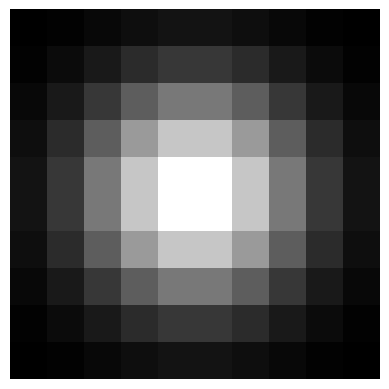

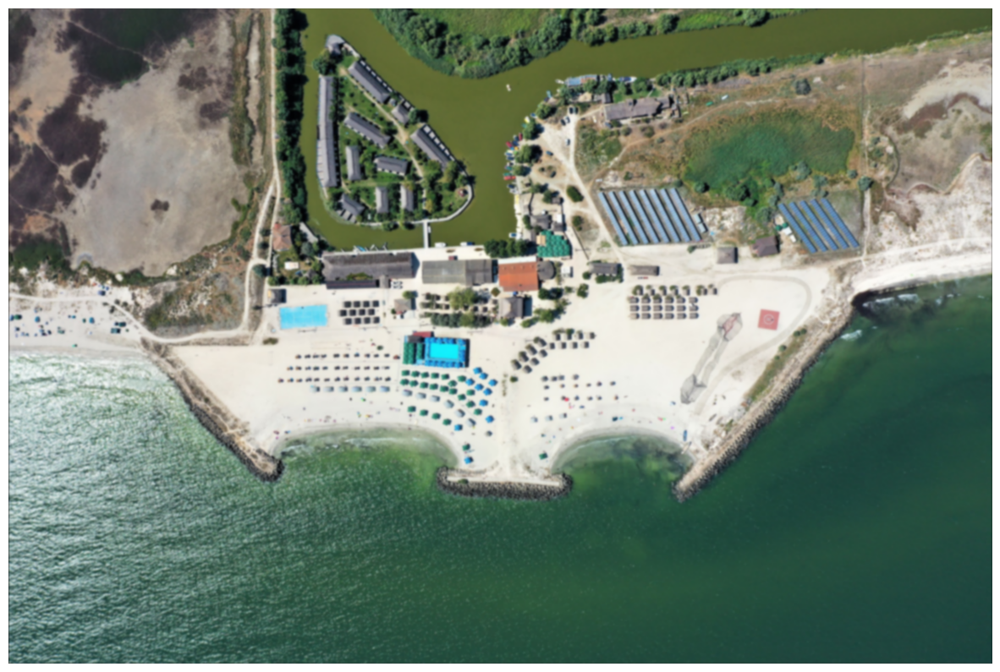

In [ ]:
# Display the Gaussian kernel (single channel) for visualization
show_image(gauss.gaussian_kernel_2D[:, :, 0])
plt.show()

# Display the Gaussian-filtered image with specified size
show_image(gaussian_image, size=15)
plt.show()


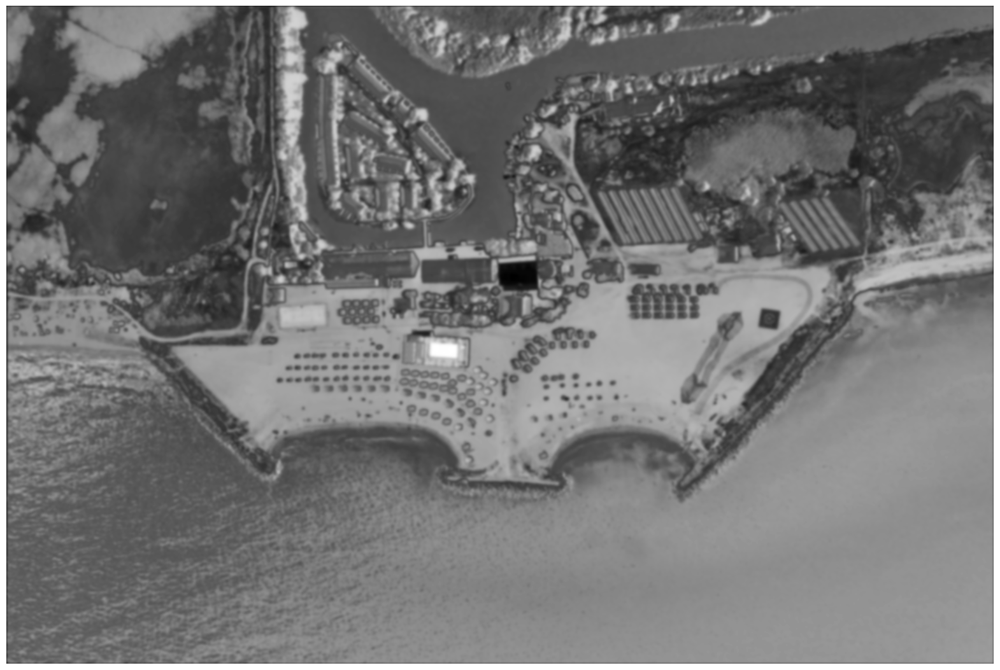

In [ ]:
# Initialize a Gaussian filter with size 20 and sigma 2.2
gaussian = Filters(20, 2.2)

# Define the target color in RGB for the distance comparison
orange_color = np.asarray([205, 128, 60])

# Compute the color distance from the `gaussian_image` to `orange_color`
color_dif = color_distance(gaussian_image, orange_color)

# Apply a Gaussian filter to smooth the `color_dif` result
color_dif = gaussian.mono_filter(color_dif, gaussian_kernel_filter(20, 2.2)[:, :, 0])

# Display the smoothed color difference image
show_image(color_dif, size=20)


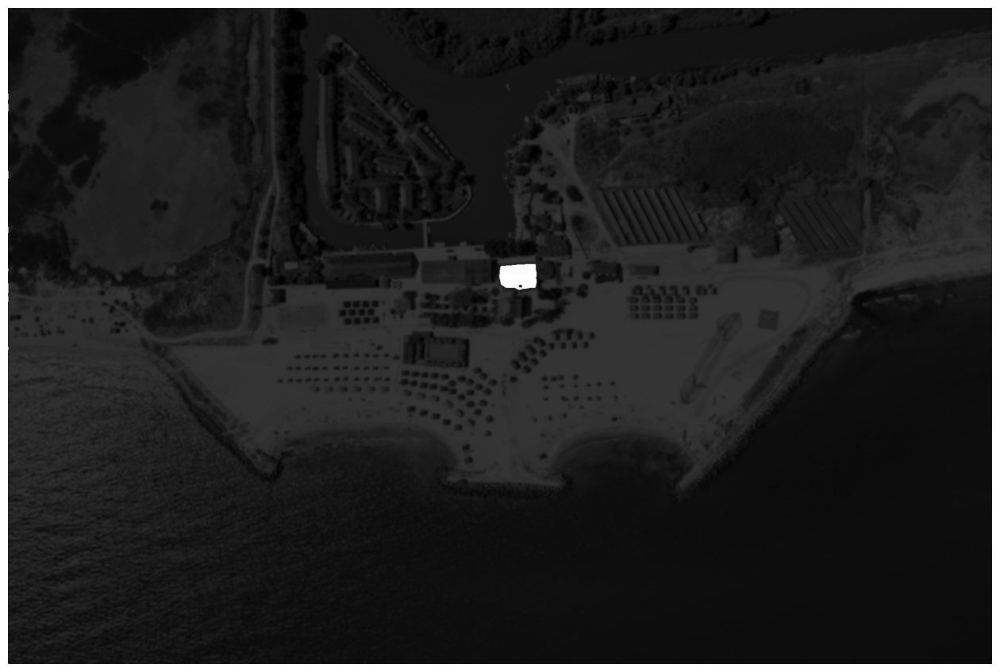

In [ ]:
# Define a threshold for color difference
thrs = 0.2

# Create a mask for areas with color difference below the threshold
mask = color_dif / color_dif.max() < thrs

# Set contrast level multiplier
ctrs = 4

# Convert the Gaussian-filtered image to grayscale and normalize
img = transform_in_gray(gaussian_image)
img = img / img.max()

# Increase contrast where the mask is applied
img = img + mask * ctrs

# Display the final processed image
show_image(img, size=16)


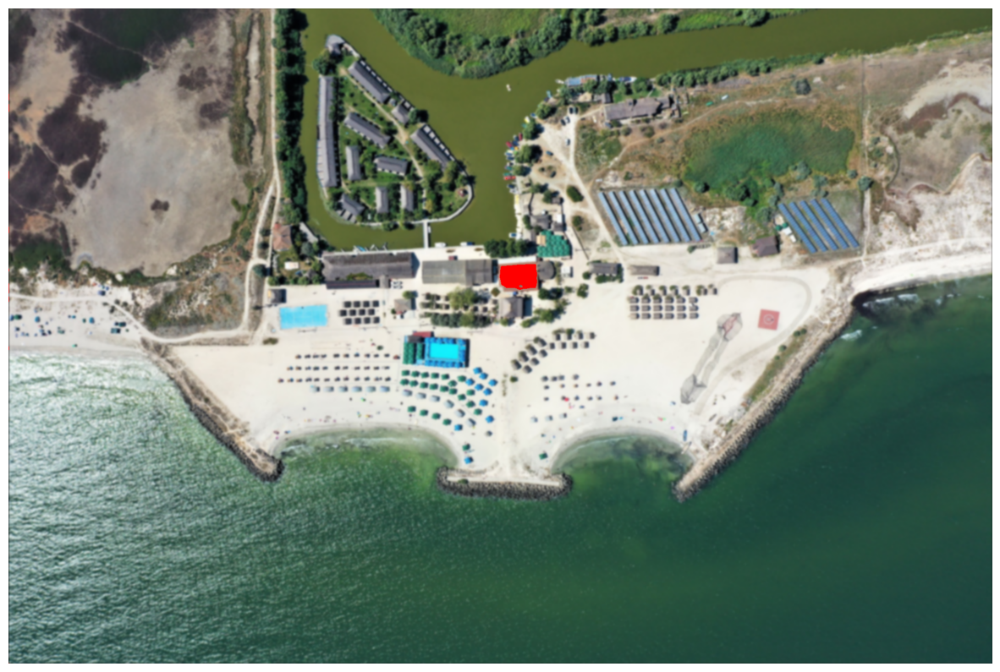

In [ ]:
# Define red color for highlighting
red_color = np.asarray([255, 0, 0])

# Apply the red color to regions in the Gaussian image where mask is True
highlght = highlight(gaussian_image, mask, red_color)

# Display the highlighted image
show_image(highlght, size=15)


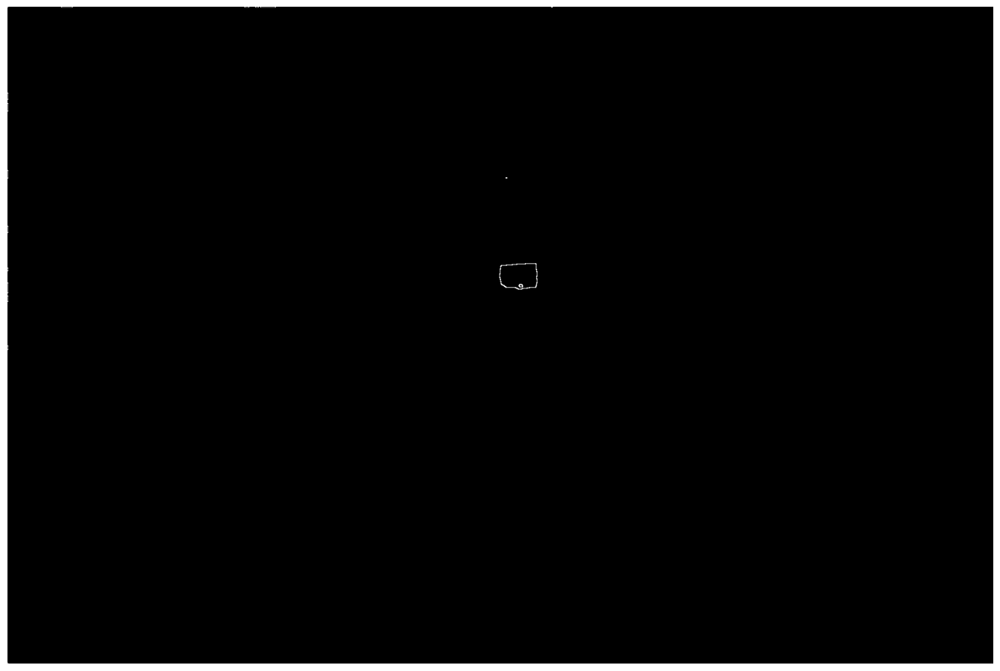

In [ ]:
# Instantiate the Filters object
filtr = Filters()

# Apply edge detection using Sobel filters
edges = filtr.detect_edges(mask, filtr.sobel_x_dir()[:, :, 0], filtr.sobel_y_dir()[:, :, 0])

# Display the edge-detected image
show_image(edges, size=17)


## 4.3

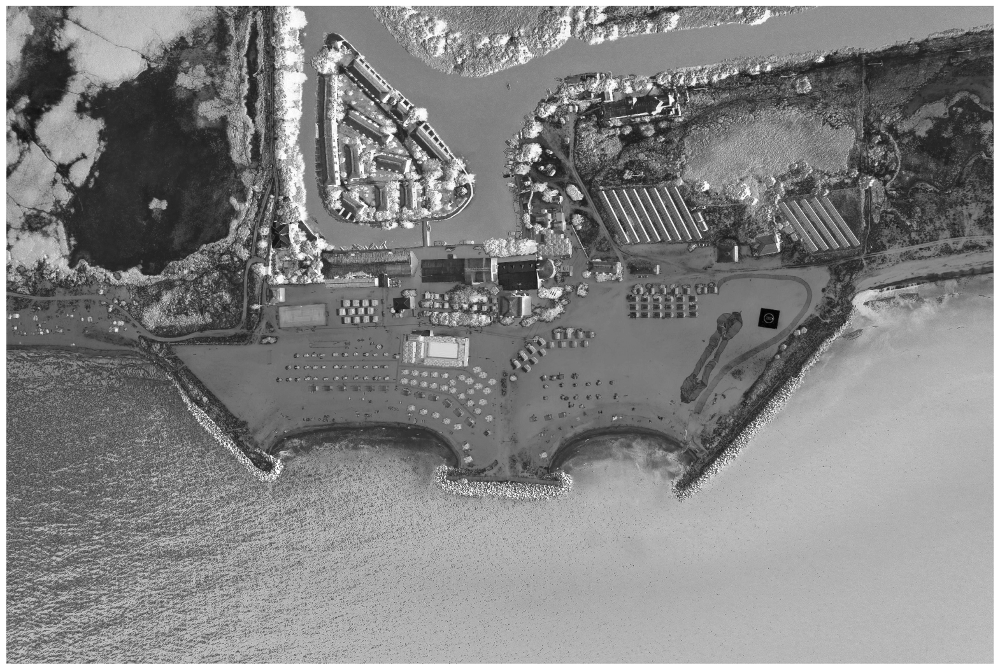

In [ ]:
# Define the target color as a NumPy array
color = np.asarray([209, 141, 142])

# Calculate the color distance from the initial_image to the specified color
color_dif = color_distance(initial_image, color)

# Normalize the color difference image to the range [0, 1]
color_dif = color_dif / color_dif.max()

# Display the normalized color difference image
show_image(color_dif, size=20)


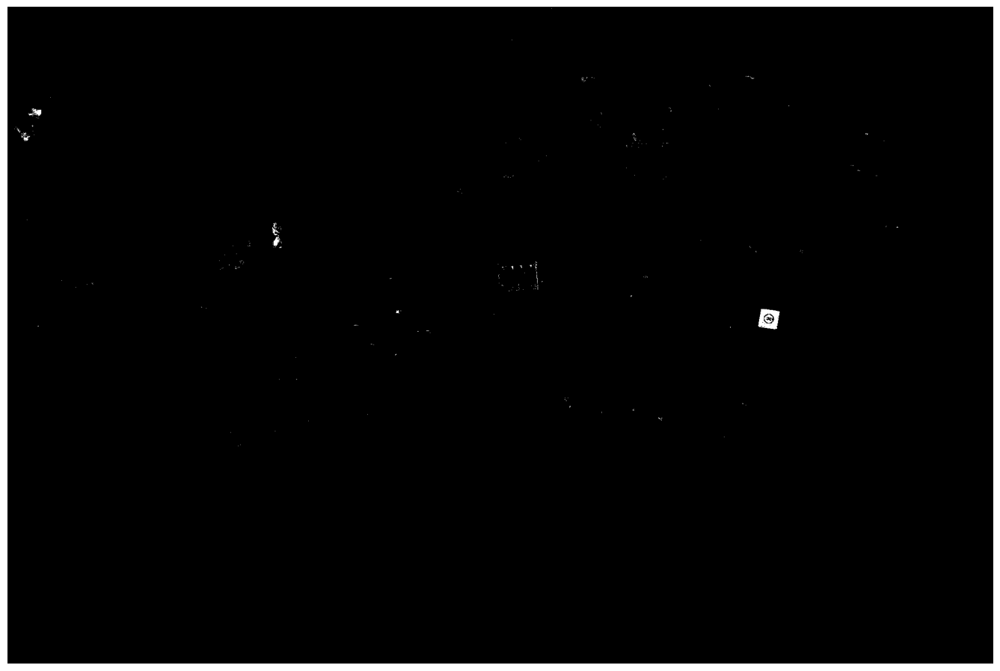

In [ ]:
# Create a binary mask where the color distance is less than 0.1
color_msk = color_dif < 0.1 

# Display the binary mask image
show_image(color_msk, size=17)


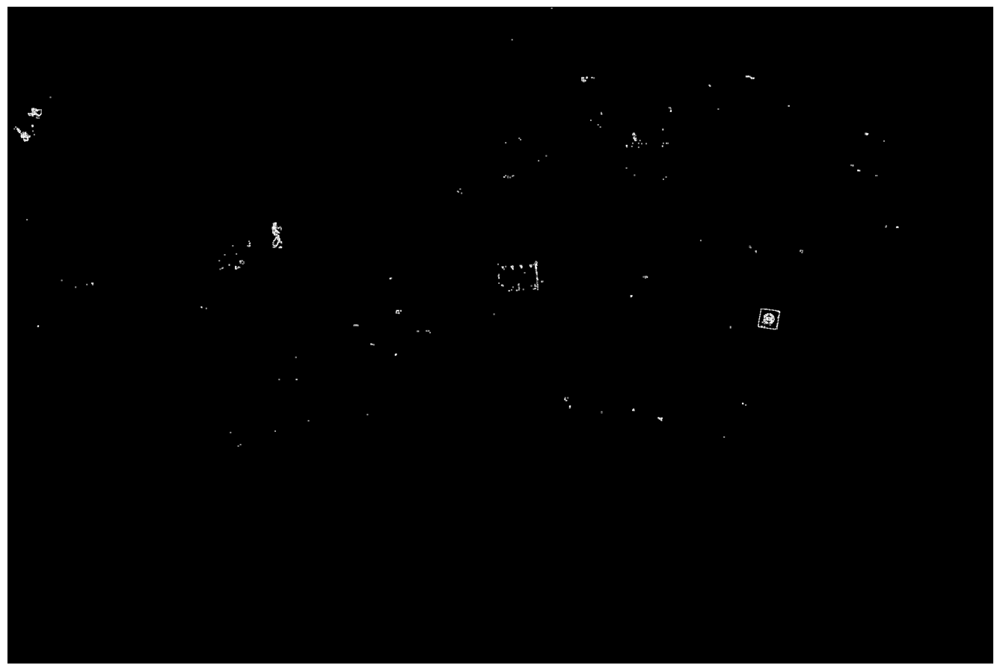

In [ ]:
# Apply edge detection on the color mask using Sobel filters
edges = filtr.detect_edges(color_msk, filtr.sobel_x_dir()[:, :, 0], filtr.sobel_y_dir()[:, :, 0])

# Display the detected edges
show_image(edges, size=17)


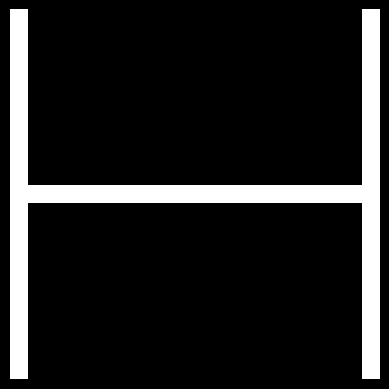

In [ ]:
def h_filter(size: int, vertical: bool = True) -> np.ndarray:
    assert size % 2 == 1, "Size must be odd"  # Ensure the filter size is odd

    h = np.zeros((size, size))  # Create a square filter initialized to zeros
    mid = size // 2  # Calculate the middle index

    if vertical:
        h[:, [0, -1]] = 1  # Set the first and last columns to 1 for vertical filter
        h[mid, :] = 1  # Set the middle row to 1
    else:
        h[[0, -1], :] = 1  # Set the first and last rows to 1 for horizontal filter
        h[:, mid] = 1  # Set the middle column to 1

    return h / h.sum()  # Normalize the filter to ensure the sum of weights is 1

fltr = h_filter(21)  # Create a H-filter of size 21x21
plt.figure(facecolor='black')  # Set the figure background color to black
show_image(fltr)  # Display the filter

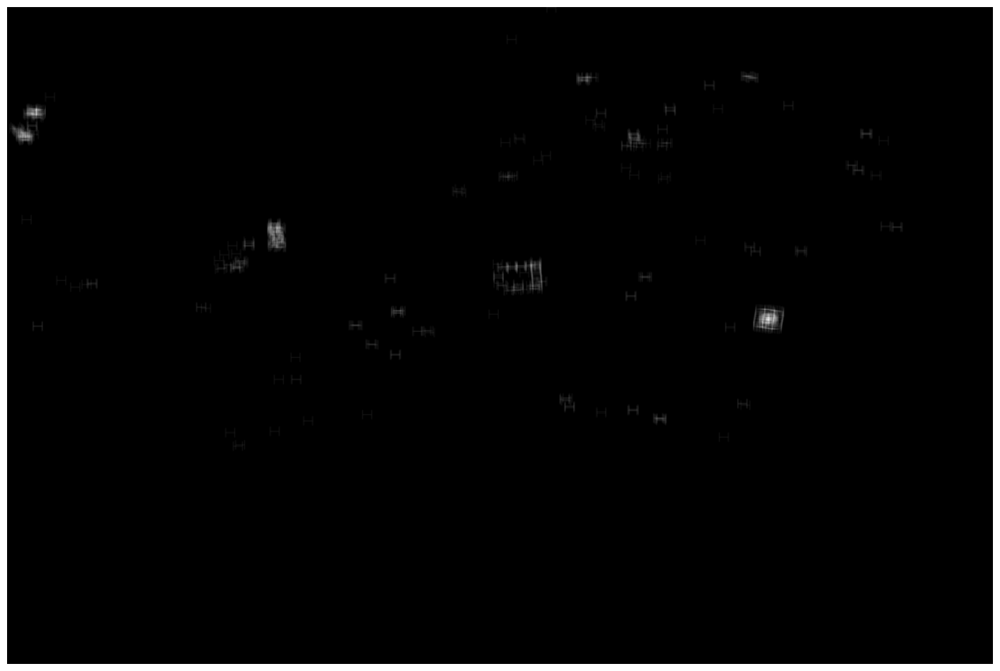

In [ ]:
gaussian = Filters(21, 2.2)  # Initialize the Gaussian filter

# Detect edges in the color mask using Sobel filters
edgs = filtr.detect_edges(color_msk, filtr.sobel_x_dir()[:, :, 0], filtr.sobel_y_dir()[:, :, 0])

# Apply the H-filter to the detected edges
new_img = gaussian.mono_filter(edgs, fltr)

# Show the resulting image
show_image(new_img, size=18)


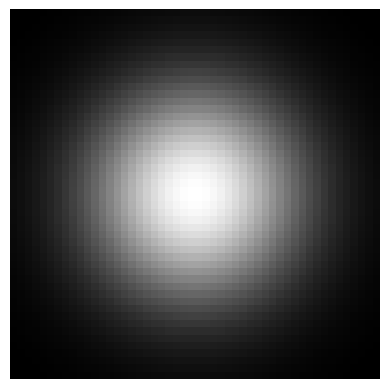

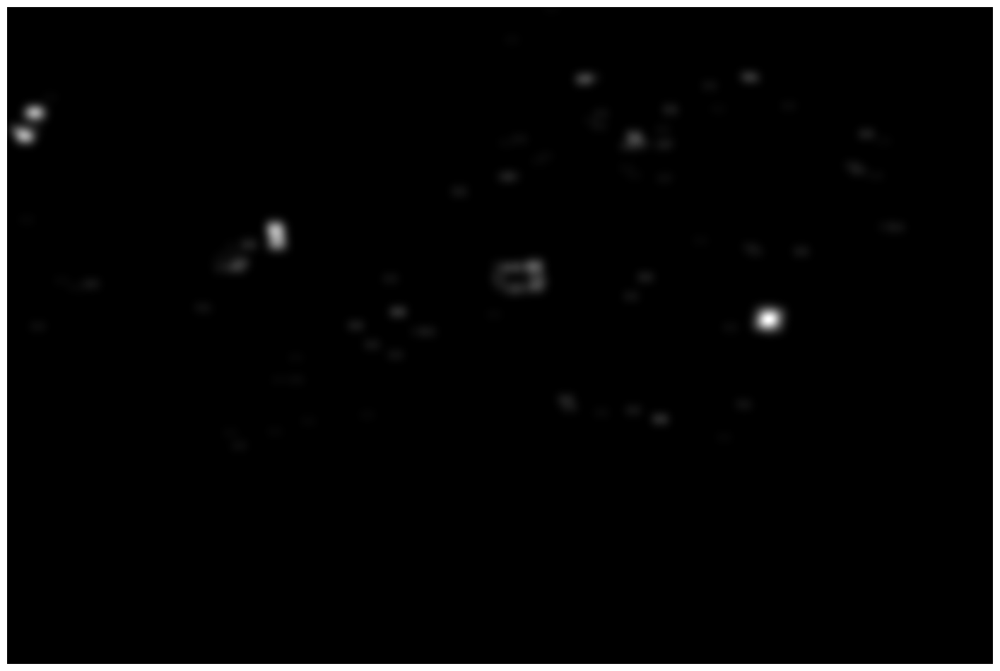

In [ ]:
# Initialize the Gaussian filter with size 50 and sigma 2.2
gauss = Filters(50, 2.2)

# Retrieve and display the Gaussian filter
gaussian_fltr = gauss.gaussian_kernel_2D[:, :, 0]
show_image(gaussian_fltr)
plt.show()

# Apply the Gaussian filter to the new image (blurred edges)
blurr = gauss.mono_filter(new_img, gaussian_kernel_filter(50, 10)[:, :, 0])

# Show the blurred image
show_image(blurr, size=18)


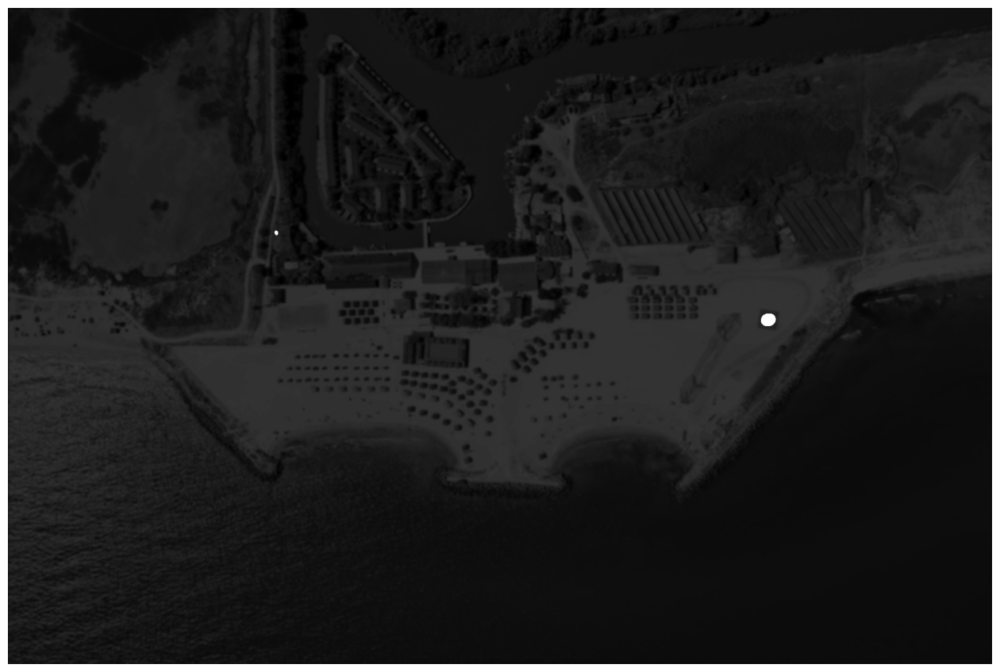

In [ ]:
# Set the threshold
thrs = 0.69

# Create a mask based on the threshold
mask = blurr / blurr.max() > thrs

# Set the enhancement constant
ctrs = 4

# Transform the gaussian image to grayscale
img = transform_in_gray(gaussian_image)

# Normalize the grayscale image
img = img / img.max()

# Enhance the grayscale image using the mask
img = img + mask * ctrs

# Show the enhanced image
show_image(img, size=16)

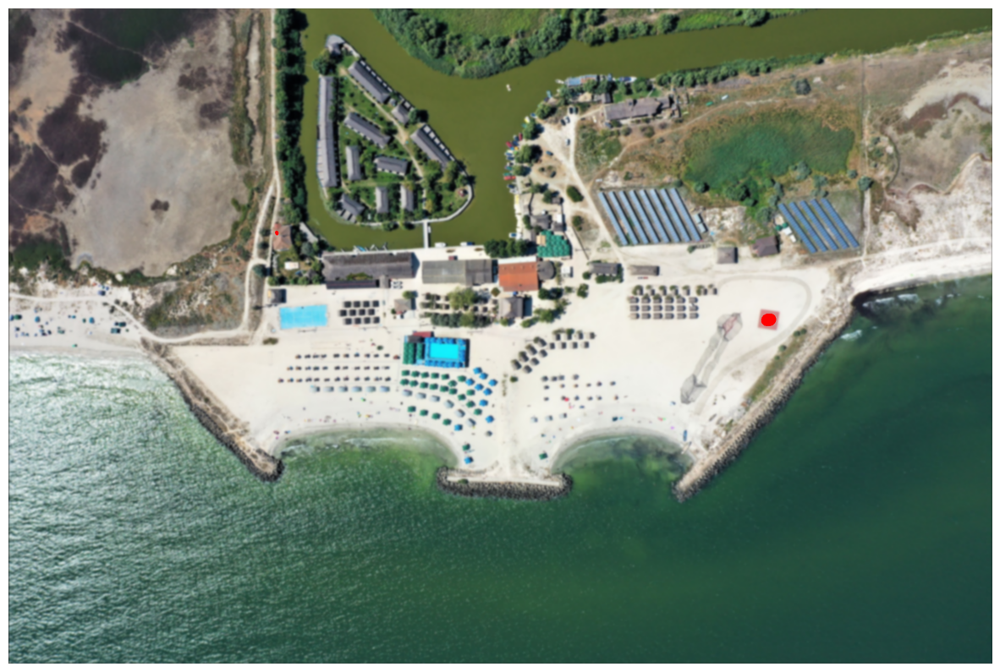

In [ ]:
# Define the highlight color (red)
red_color = np.asarray([255, 0, 0])

# Highlight the regions specified by the mask in the original image
highlght = highlight(gaussian_image, mask, red_color)

# Show the highlighted image
show_image(highlght, size=15)